# Foundations of Computer Vision: Applied Projects


This Jupyter notebook series contains the bases of the laboratories you need to develop during the semester.

The main goal of those projects is twofold: 1st is to reiterate the theoretical context of the lectures and 2nd to use those methods in adapted examples for real-world scenarios.

## Import libraries, util functions and test image loading



Libraries that you can use (not mandatory) and some auxiliar functions that could be useful on this block.

In [1]:
!pip3 install -U imutils
!pip3 install imutils
import cv2
import urllib3
import numpy as np
from PIL import Image
import imutils
from matplotlib import pyplot as plt



[notice] A new release of pip is available: 23.3 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.3 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
def add_noise(image, noise_type, mean=0, std=0.01, amount=0.05, salt=0.5):
    """
    Add noise to an image.

    Parameters:
    - image: numpy array of shape (H, W) for grayscale or (H, W, 3) for RGB
    - noise_type: string, one of 'gaussian', 'salt_pepper', 'speckle'
    - params: dictionary containing parameters specific to the noise type

    Returns:
    - noisy_image: numpy array with added noise
    """

    if noise_type == 'gaussian':
        sigma = std**0.5
        noise = np.random.normal(mean, sigma, image.shape).astype(image.dtype)
        noisy_image = cv2.add(image, noise)

    elif noise_type == 'salt_pepper':
        out = np.copy(image)
        # Salt mode
        num_salt = np.ceil(amount * image.size * salt)
        coords = [np.random.randint(0, i-1, int(num_salt)) for i in image.shape]
        out[tuple(coords)] = 1
        # Pepper mode
        num_pepper = np.ceil(amount*image.size*(1. - salt))
        coords = [np.random.randint(0, i-1, int(num_pepper)) for i in image.shape]
        out[tuple(coords)] = 0
        noisy_image = out

    elif noise_type == 'speckle':
        noise = np.random.randn(*image.shape).astype(image.dtype)
        noisy_image = image + image * noise

    else:
        raise ValueError(f"Noise type '{noise_type}' is not supported.")

    # Clip values to be in [0, 255]
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image

def add_periodic_noise(image, frequency=5, amplitude=10):
    X, Y = np.meshgrid(np.arange(image.shape[0]),np.arange(image.shape[1]))

    noise = amplitude * np.sin(2 * np.pi * frequency * Y / image.shape[0])

    noisy_image = image + noise

    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image


In [3]:
#VISUALIZATIONS
def visualize(images,titles,suptitles,n):
    fig, axes = plt.subplots(1, len(images), figsize=(10, 5))
    for i in range(len(images)):
        axes[i].imshow(images[i], cmap='gray')
        axes[i].set_title(titles[i])
        axes[i].axis("off")
    if suptitles != None:
        plt.suptitle(suptitles[n])
    plt.tight_layout()
    plt.show()

# Block 1. Linear filtering
This block focuses on linear filtering, one of the foundational concepts in image processing and computer vision. We'll be delving deep into how convolution operates, the distinction between convolution and correlation, and the magic of the Fourier transform in image filtering.

### Objectives:

1. **Implement and Learn How Convolution Works:**  
   A self-implemented convolution function and its application on sample images.

2. **Use Convolution to Apply Linear Filters:**  
   Blurred and edge-detected versions of input images using your convolution function.

3. **Compare Convolution and Correlation:**  
   Implementation of correlation function and comparison with convolution.

4. **Normalized Cross-Correlation and Use for Template Matching:**  
   Function to locate a template within a larger image.

5. **Fourier Transform and Image Filtering:**  
   Filtered images emphasizing or de-emphasizing certain frequency components.

---

### Mandatory Questions:

- What is the purpose of image filtering in computer vision? Can you list some common applications?

- Why do we often use odd-sized kernels in image filtering? When we want to use even-sized filters?

- Why do we often use a flipped version of the kernel in the convolution operation?

- What is the fundamental difference between convolution and correlation? Can you demonstrate this with an example?

- How does changing the size of the kernel affect the outcome of the convolution operation?

- Explain the process of convolution and how it is used to apply a filter to an image.

- In your own words, explain the significance of the Fourier transform in image processing.

- Describe the process and the underlying principle of template matching using normalized cross-correlation.

- Why might one choose to operate in the frequency domain (using Fourier transform) instead of the spatial domain when processing an image?

- Can we remove "salt and pepper" noise with some of those linear filters?  


### Optional Deep Dive Questions:

- Besides convolution, what are other methods to apply filters to an image? Can you compare and contrast these methods?

- Explore the concept of separable kernels. What benefits do they provide in convolution?

- What is the purpose of the padding in the convolution operation, and what are the different types of padding? Explain also the purpose of stride and how this affects the output?

- Explain which types of filters might be important for a real-scenario application (e.g., self-driving car vision system, medical image analysis).

- What are the limitations of linear filters when it comes to noise reduction? Are there scenarios where they might not be ideal?

- How would might you extend the concepts of convolution to color images? Which complexities arise when dealing with multiple channels?

- Fourier transform is used in various fields outside of image processing. Can you find and explain an application outside of computer vision?

- Explore and explain the difference between the discrete Fourier transform (DFT) and the fast Fourier transform (FFT). Why might FFT be preferred in many applications?


## Convolution operation



#### Objective:
Implement the convolution operation by hand and compare it with standard library functions. Also, manipulate image sizes through upsampling and downsampling using convolution. The focus will be on handling edge cases and experimenting with various kernels.

---

#### Guideline:
1. Implement a function to perform the convolution operation on an image. Make sure to handle edge cases and allow for different kernel sizes. DO NOT USE LIBRARY IMPLEMENTATIONS.
2. Develop methods for upsampling and downsampling images using your convolution function.
3. Experiment with your convolution function by applying different kernels on various images.
4. Compare your hand-implemented convolution outcomes with standard library methods such as OpenCV's `filter2d` and SciPy's `convolve`.

---

#### Expected results:
- Your hand-implemented convolution, upsampling, and downsampling code.
- Resized images at scales: (2x, 0.5x).

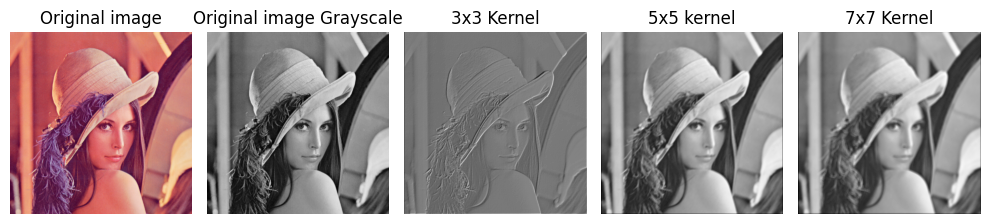

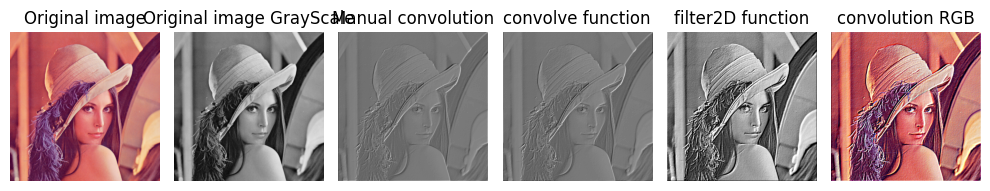

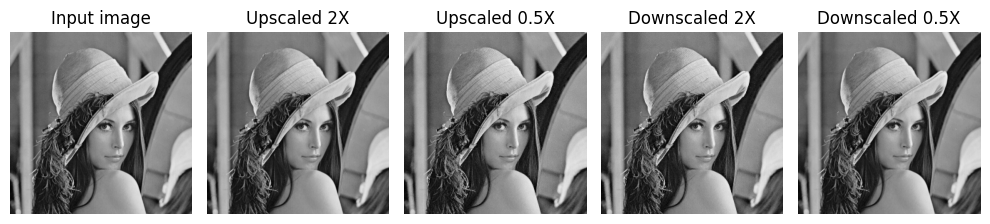

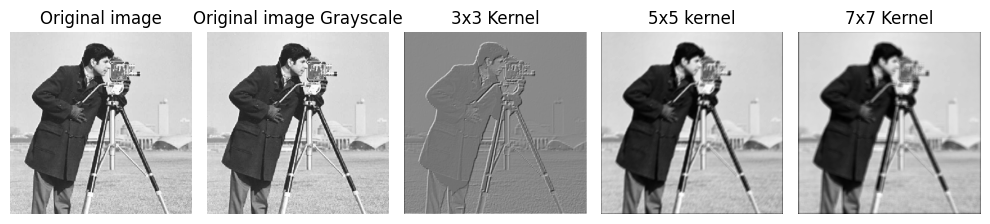

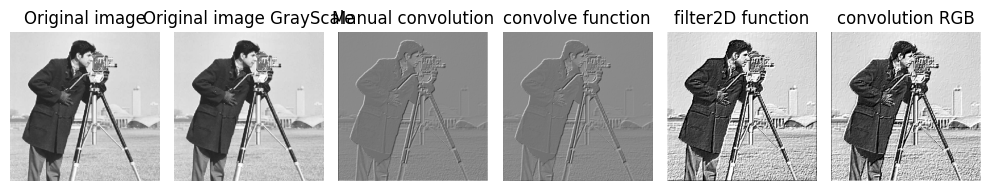

...

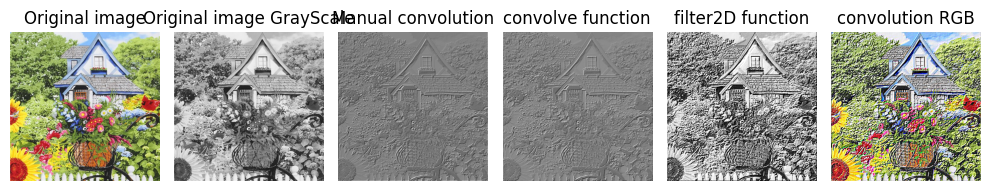

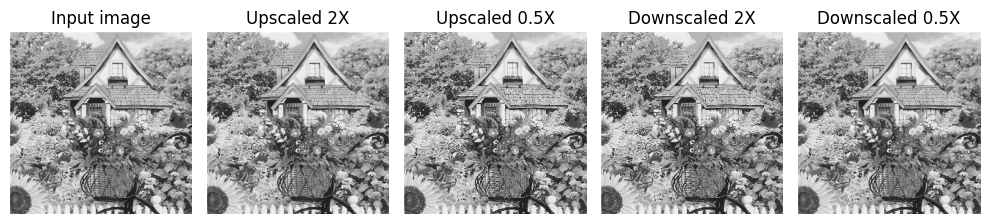

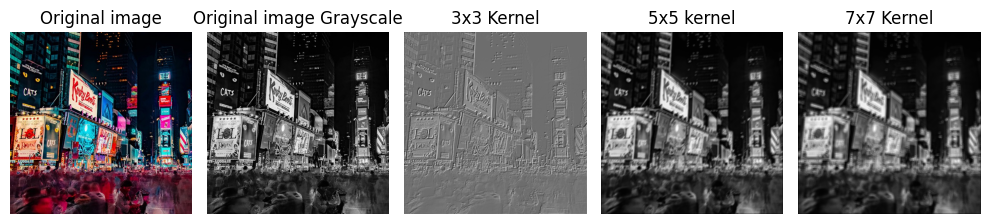

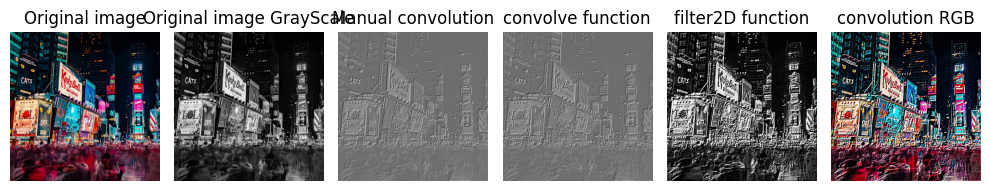

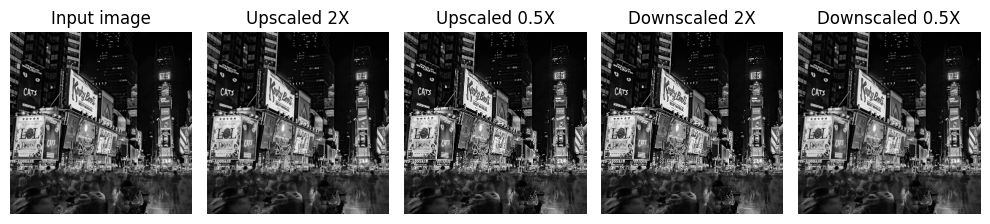

In [4]:
# OUR FUNCTIONS
def convolution(image,kernel,stride =1, padding=0):
  """
  Applies convolution to an image manually, without using library implementations.
  """
  # Size of kernel, input image and output image
  image_height, image_width = image.shape
  kernel_height, kernel_width = kernel.shape

  output_image = np.zeros((image_height,image_width)) #if stride !=1, this is not correct

  #Flip kernel
  flipped_kernel = kernel[::-1, ::-1] #first reverses order of rows, second reverses order of columns

  #Padding
  # Calculate the padding required for the given kernel size
  padding_height = kernel_height//2
  padding_width = kernel_width//2
  # Initialize the padded image with zeros
  padded_image = np.zeros((image_height + 2 * padding_height, image_width + 2 * padding_width))
  # Copy the original image into the center of the padded image
  padded_image[padding_height:padding_height + image_height, padding_width:padding_width + image_width] = image

  #Do convolution row by row of image
  for i in range(image_height):  #i = row we're in
    for j in range(image_width):  #j = column we're in
      roi = padded_image[i:i+kernel_width,j:j+kernel_height]  #Region of interest (np array we want to multiply by kernel)
      convolution_result = np.sum(roi * flipped_kernel)
      output_image[i,j] = convolution_result

  return output_image

def convolution_rgb(image, kernel, stride=1, padding=0):
    """
    Applies convolution to an RGB image manually, without using library implementations.
    """
    # Size of kernel, input image and output image
    image_height, image_width, _ = image.shape
    kernel_height, kernel_width = kernel.shape

    output_image = np.zeros_like(image)  # Create an empty output image of the same shape as the input

    # Flip kernel
    flipped_kernel = kernel[::-1, ::-1]  # Reverse the order of rows and columns

    # Padding
    padding_height = kernel_height // 2
    padding_width = kernel_width // 2
    padded_image = np.pad(image, ((padding_height, padding_height), (padding_width, padding_width), (0, 0)), mode='constant')

    # Do convolution for each color channel
    for channel in range(3):  # There are 3 channels: Red, Green and Blue
        for i in range(padding_height, image_height+padding_height):
            for j in range(padding_width, image_width+padding_width):
                roi = padded_image[i-padding_height:i+padding_height+1, j-padding_width:j+padding_width+1, channel]  # Region of interest
                convolution_result = np.sum(roi * flipped_kernel)
                output_image[i-padding_height, j-padding_width, channel] = min(max(int(convolution_result), 0), 255)

    return output_image


def gaussian_kernel(size, sigma): #NOT USED
    kernel = np.zeros((size, size))
    center = size// 2
    for i in range(size):
        for j in range(size):
            x, y = i, j
            kernel[i, j] = np.exp(-(x**2 + y**2) / (2 * sigma**2))

    kernel = kernel / (2 * np.pi * sigma**2)
    kernel = kernel / np.sum(kernel)  # Normalize the kernel
    return kernel

def upscale_image(image, scale_factor):
    #Calculate new dimensions
    image_height, image_width = image.shape
    new_height, new_width = int(image_height * scale_factor), int(image_width * scale_factor)

    #Output upscaled image
    upscaled_image = np.zeros((new_height,new_width))

    #Use interpolation (nearest neighbour) to get new pixels
    for i in range(new_height): #row
       for j in range(new_width): #column
          #Get corresponding row and column from original image
          upscaled_image[i, j] = image[int(i / scale_factor), int(j / scale_factor)]

    return upscaled_image

def downscale_image(image, scale_factor):
    #Calculate new dimensions
    height, width = image.shape
    new_height, new_width = int(height / scale_factor), int(width / scale_factor)

    #Output downscaled image
    downscaled_image = np.zeros((new_height, new_width))

    #Use NN interpolation
    for i in range(new_height):
        for j in range(new_width):
            downscaled_image[i, j] = image[int(i * scale_factor), int(j * scale_factor)]

    return downscaled_image


# FUNCTIONS IMPLEMENTING LIBRARY FUNCTIONS
from scipy.signal import convolve2d

def convolution_function1(image, kernel, stride=1, padding=0):
    """
    Apply convolution using numpy's convolve function
    """
    output_image = convolve2d(image, kernel,mode="same",boundary="wrap")
    return output_image

def convolution_function2(image, kernel, stride=1, padding=0):
    """"
    Apply convolution using OpenCV's filter2D function
    """
    output_image = cv2.filter2D(image, -1, kernel, borderType=cv2.BORDER_CONSTANT)
    # Normalize the output image to the range [0, 255] for display
    output_image = cv2.normalize(output_image, None, 0, 255, cv2.NORM_MINMAX)
    return output_image

#MAIN

#Different kernels for testing
kernel = np.array([[-2, -1, 0],
                  [-1, 1, 1],
                  [0, 1, 2]])
kernel_2 = np.array([[1,2,1,4,2],
                    [0,2,1,2,3],
                    [3,1,2,5,1],
                    [2,3,1,0,2],
                    [4,5,2,1,0]])
kernel_3 = np.array([[1,2,1,4,2,3,7],
                    [0,2,1,2,3,2,2],
                    [3,1,2,5,1,1,4],
                    [2,3,1,0,2,1,7],
                    [4,5,2,1,0,8,2],
                    [2,3,6,7,2,1,3],
                    [1,0,3,5,7,6,5]])

#Get images
images = ["lenna.png","cameraman.png","casacampo.jpg","city.jpg"]

for image in images:
    if image is None:
        print("Image not found")
    else:
        image_copy1 = image
        image1 = cv2.imread(f"images/{image_copy1}",cv2.IMREAD_COLOR)#the colours are printed in the other way around; B,G,R. So we need to change it 
        image_copy_color = image1.copy()
        image_copy_color[:,:,0]= image1[:,:,-1]
        image_copy_color[:,:,-1] = image1[:,:,0]
        image = cv2.imread(f"images/{image}",cv2.IMREAD_GRAYSCALE)

        #COMPARE ORIGINAL IMAGE WITH DIFFERENT KERNELS
        output_image_1 = convolution(image,kernel,stride=1,padding=0)
        output_image_2 = convolution(image,kernel_2,stride=1,padding=0)
        output_image_3 = convolution(image,kernel_3,stride=1,padding=0)
        images = [image_copy_color,image,output_image_1,output_image_2,output_image_3]
        titles = ["Original image", "Original image Grayscale","3x3 Kernel","5x5 kernel","7x7 Kernel"]
        visualize(images,titles,None,None)

        #COMPARE MANUAL CONVOLUTION WITH FUNCTION CONVOLUTIONS
        output_image_1 = convolution(image,kernel,stride=1,padding=0)
        output_image_2 = convolution_function1(image,kernel,stride=1,padding=0)
        output_image_3 = convolution_function2(image,kernel,stride=1,padding=0)
        output_image_4 = convolution_rgb(image_copy_color,kernel,stride=1,padding=0)
        titles = ["Original image","Original image GrayScale","Manual convolution","convolve function","filter2D function", "convolution RGB"]
        images = [image_copy_color,image,output_image_1,output_image_2,output_image_3, output_image_4]
        visualize(images,titles,None,None)

        #UPSCALE AND DOWNSCALE IMAGES AT 2X AND 0,5X
        output_image_1 = upscale_image(image, 2)
        output_image_2 = upscale_image(image, 0.5)
        output_image_3 = downscale_image(image, 2)
        output_image_4 = downscale_image(image, 0.5)
        titles = ["Input image","Upscaled 2X","Upscaled 0.5X","Downscaled 2X", "Downscaled 0.5X"]
        images = [image,output_image_1,output_image_2,output_image_3,output_image_4]
        visualize(images,titles,None,None)


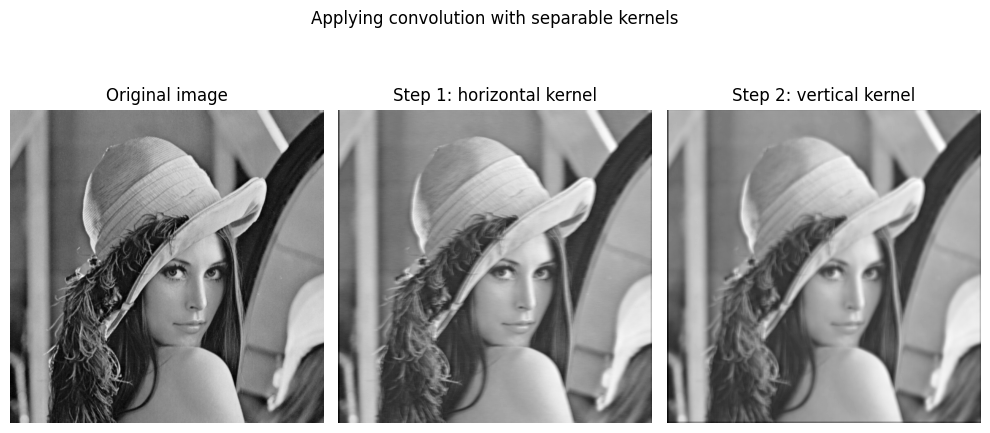

In [5]:
#APPLYING CONVOLUTION WITH SEPARABLE KERNELS
kernels = [kernel_3]

image = cv2.imread(f"images/lenna.png",cv2.IMREAD_GRAYSCALE)

for kernel in kernels:
    # Separate 2D kernel in 2 1D kernels
    kernel_x = kernel[0, :]  # 1D horizontal kernel
    kernel_y = kernel[:, 1]  # 1D vertical kernel
    kernel_x = kernel_x.astype(np.float64)
    kernel_y = kernel_y.astype(np.float64)
    # Normalize the kernels
    kernel_x /= np.sum(kernel_x)
    kernel_y /= np.sum(kernel_y)
    # Apply separable convolution in two steps
    convolved_x = np.apply_along_axis(lambda x: np.convolve(x, kernel_x, mode='same'), axis=1, arr=image)
    convolved_result = np.apply_along_axis(lambda x: np.convolve(x, kernel_y, mode='same'), axis=0, arr=convolved_x)

    #Visualization
    titles = ["Original image","Step 1: horizontal kernel","Step 2: vertical kernel"]
    images = [image,convolved_x,convolved_result]
    visualize(images,titles,["Applying convolution with separable kernels"],0)

## Linear Filtering


#### Objective:
Explore various image filtering techniques by applying them to a set of example images as well as images of your own choice. Experiment with different kernel sizes and types of filters to observe their effects.

- Blur:
  - Average Box Filter
  - Gaussian Filter
- Edge:
  - Laplacian Filter
  - Sobel Filter
  - Prewitt Filter

Feel free to experiment with additional filters as well.

---

#### Guideline:
1. Apply each of the given filters to the example images provided.
2. Use images of your own choosing to further experiment with these filters.
3. Experiment with varying kernel sizes for each filter.
4. Analyze the effects of each filter and kernel size on the images.

---

#### Expected results:
- Filtered images (both example and your own)
- Analysis of the effect of kernel size


Examples of different linear filters for blur and edge *detection*

1. **Average Box Filter:**
   ```
   1/9  1/9  1/9
   1/9  1/9  1/9
   1/9  1/9  1/9
   ```

2. **Gaussian Blur Filter:**
   ```
   1/16  2/16  1/16
   2/16  4/16  2/16
   1/16  2/16  1/16
   ```

3. **Laplacian Filter:**
   ```
   0  1  0
   1 -4  1
   0  1  0
   ```

4. **Sobel Operator (horizontal || vertical):**
   ```
     -1  0  1  ||  -1 -2 -1
     -2  0  2  ||   0  0  0
     -1  0  1  ||   1  2  1
  ```

5. **Prewitt Operator (horizontal || vertical):**
   ```
    -1  0  1  || -1 -1 -1
    -1  0  1  ||  0  0  0
    -1  0  1  ||  1  1  1
   ```



In [6]:
#FILTERS
kernel_box = np.ones((3, 3), np.float32) / 9
kernel_gaussian = np.array([[1/16, 2/16, 1/16],
                          [2/16, 4/16, 2/16],
                          [1/16, 2/16, 1/16]])
kernel_Laplacian = np.array([[0,1,0],
                             [1,-4,1],
                             [0,1,0]])
sobel_x = np.array([[-1, 0, 1],
                    [-2, 0, 2],
                    [-1, 0, 1]])
sobel_y = np.array([[-1, -2, -1],
                    [0, 0, 0],
                    [1, 2, 1]])
Prewitt_x = np.array([[-1, 0, 1],
                    [-1, 0, 1],
                    [-1, 0, 1]])
Prewitt_y = np.array([[-1, -1, -1],
                    [0, 0, 0],
                    [1, 1, 1]])

kernels = [kernel_box,kernel_gaussian,kernel_Laplacian]
double_kernels = [[sobel_x,sobel_y],[Prewitt_x,Prewitt_y]]
kernel_names = ["Kernel Box","Kernel Gaussian","Kernel Laplacian"]
double_kernel_names = ["Sobel", "Prewitt"]

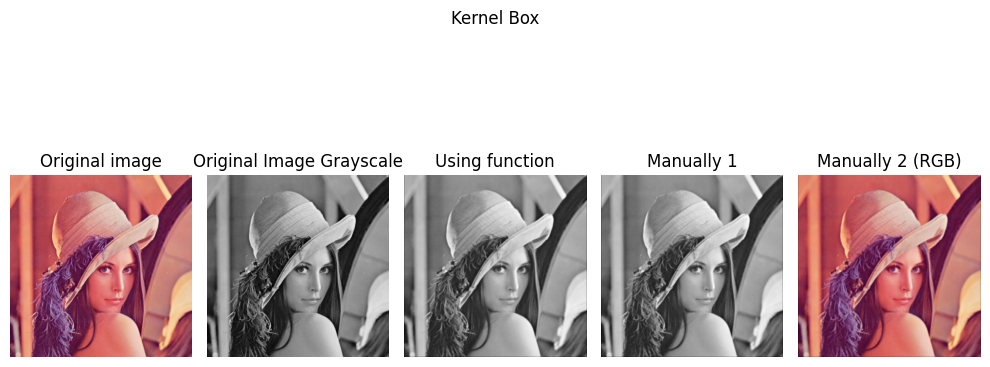

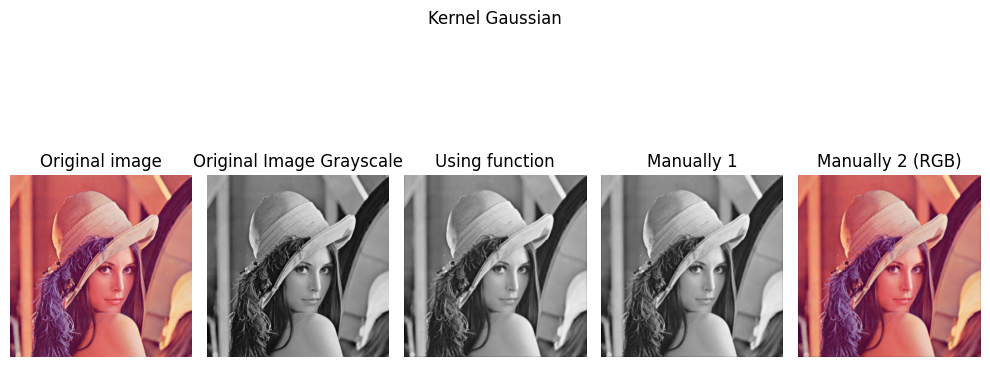

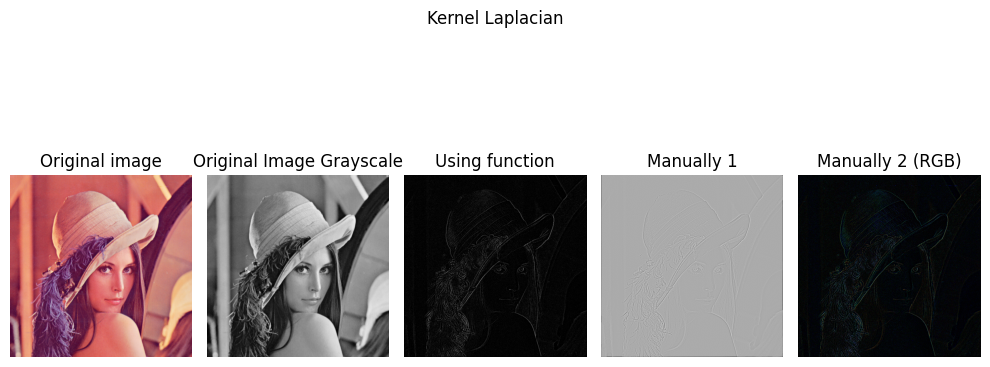

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


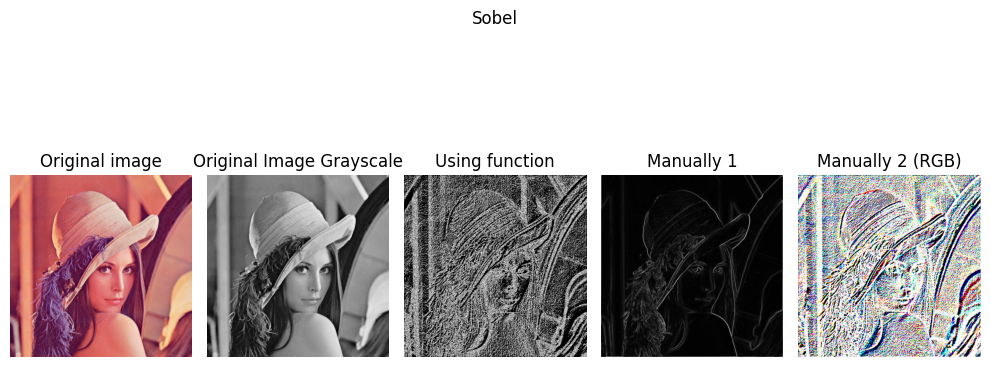

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


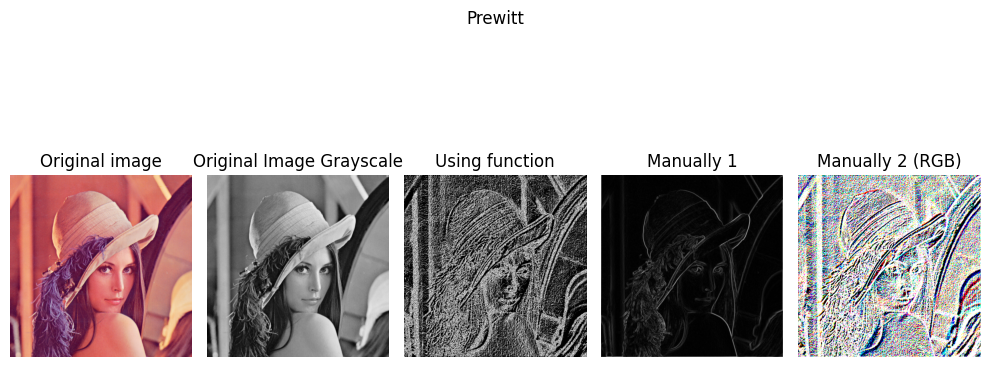

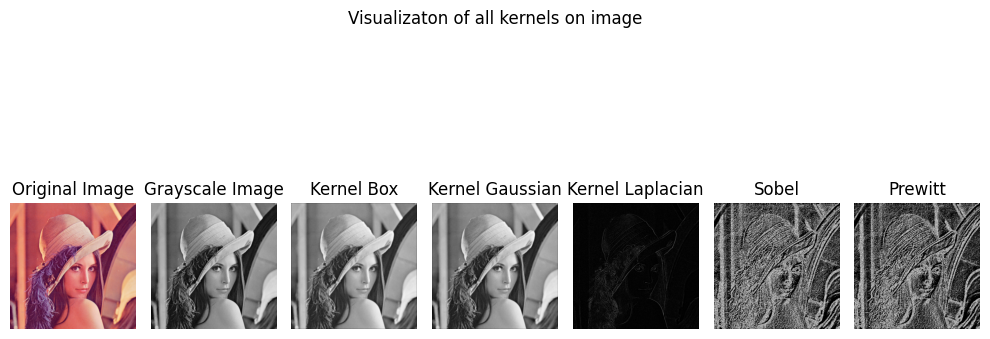

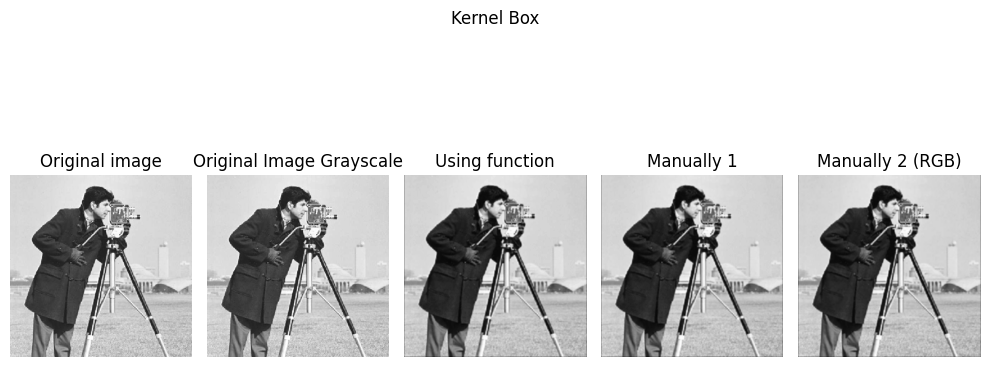

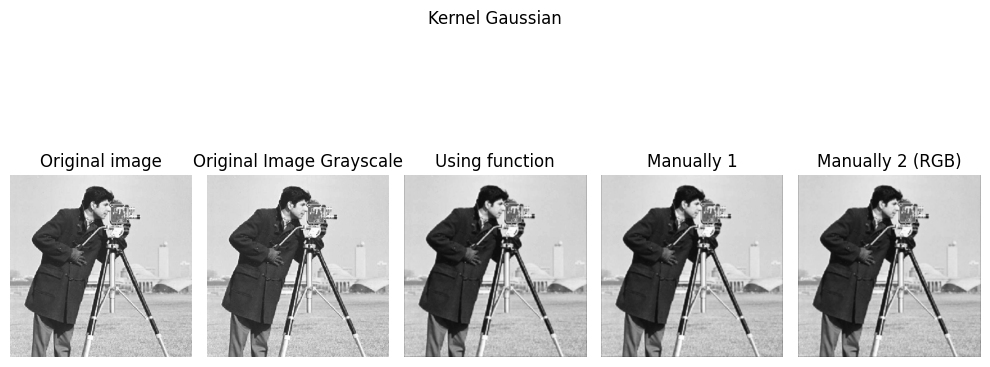

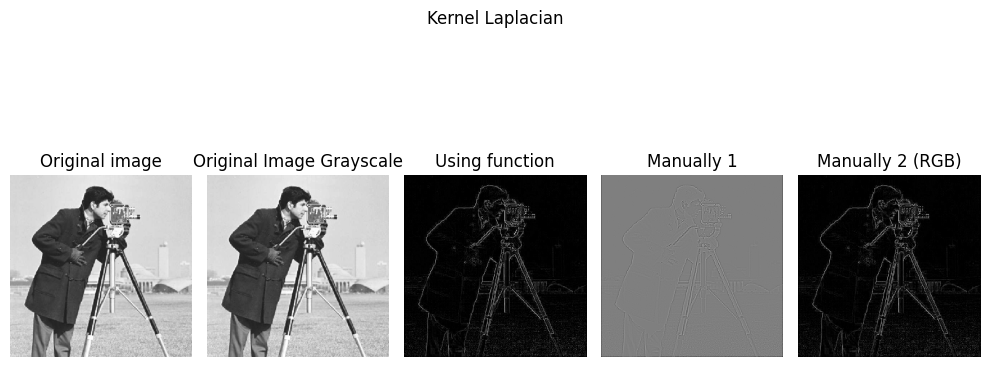

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


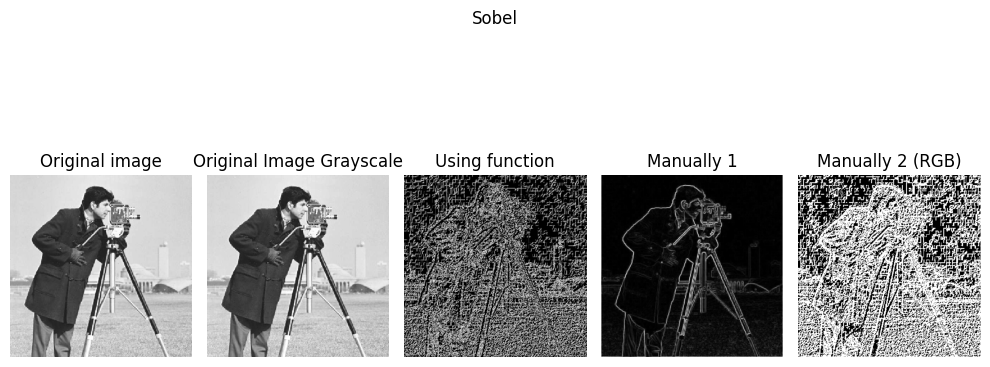

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


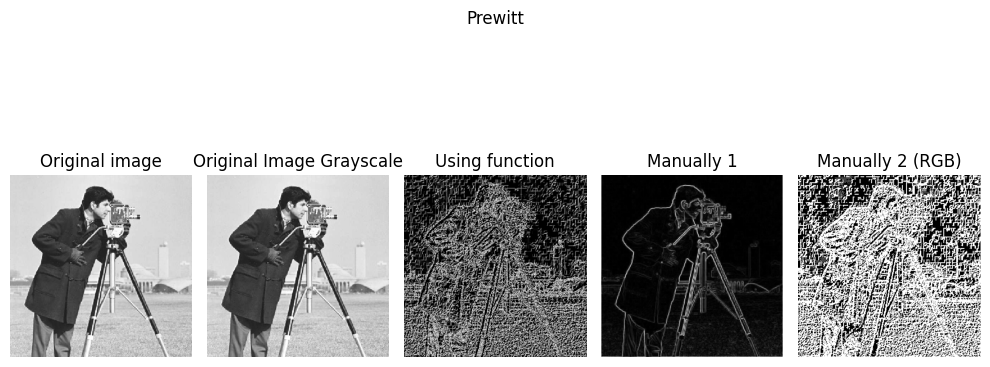

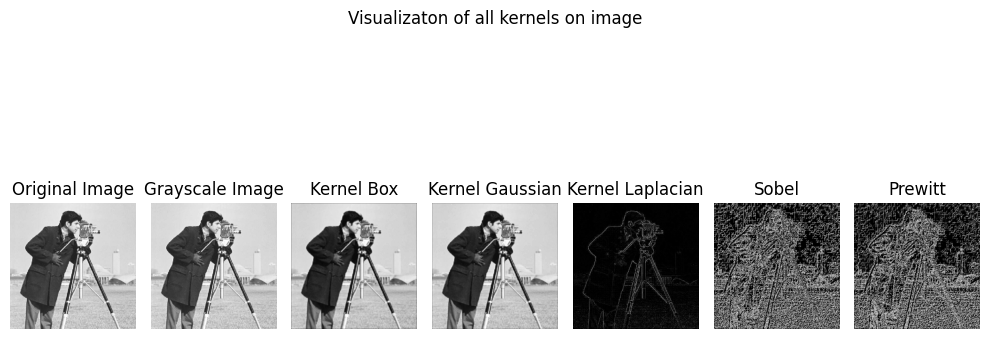

KeyboardInterrupt: 

In [8]:
#using filter2D function
def apply_linear_filter_usingfunction(image, kernel):
    output_image = cv2.filter2D(image, -1, kernel, borderType=cv2.BORDER_CONSTANT)
    # Normalize the output image to the range [0, 255] for display
    output_image = cv2.normalize(output_image, None, 0, 255, cv2.NORM_MINMAX)
    return output_image

#manually1 == convolution function calling
def apply_linear_filter1(image, kernel):
    output = convolution(image,kernel,stride=1,padding=0)
    return output
#Manually1 = convolution for rgb images
def apply_linear_filter2(image, kernel):
    output_image = convolution_rgb(image,kernel,stride=1,padding=0)
    output_image = cv2.normalize(output_image, None, 0, 255, cv2.NORM_MINMAX)
    return output_image


images = ["lenna.png","cameraman.png","distorted_checkers.jpg"]

for image_name in images:
    image = cv2.imread(f"images/{image_name}",cv2.IMREAD_GRAYSCALE)
    if image is None:
        print("Image not found")
    else:
        #Turn color image to RGB
        image2 = cv2.imread(f"images/{image_name}",cv2.IMREAD_COLOR)
        image_color = image2.copy()
        image_color[:,:,0]= image2[:,:,-1]
        image_color[:,:,-1] = image2[:,:,0]
        #Store outputs for visualization
        all_kernel_outputs = [image_color,image]

        #APPLY LINEAR FILTERING
        #Individual kernels
        for i in range(len(kernels)):
            output_image_1 = apply_linear_filter_usingfunction(image, kernels[i])
            output_image_2 = apply_linear_filter1(image, kernels[i])
            output_image_3 = apply_linear_filter2(image_color, kernels[i])
            titles = ["Original image","Original Image Grayscale", "Using function", "Manually 1", "Manually 2 (RGB)"]
            images = [image_color,image,output_image_1,output_image_2, output_image_3]
            visualize(images,titles,kernel_names,i)
            all_kernel_outputs.append(output_image_1)#Store kernels
        #Double kernels
        for k in range(len(double_kernels)):
            for a in range(1):
                out_image_1_1 = apply_linear_filter_usingfunction(image, double_kernels[k][a])
                out_image_1_2 = apply_linear_filter_usingfunction(image, double_kernels[k][a+1])
                output_image_1 = (out_image_1_1**2+out_image_1_2**2)**(1/2)
                out_image_2_1 = apply_linear_filter1(image, double_kernels[k][a])
                out_image_2_2 = apply_linear_filter1(image, double_kernels[k][a+1])
                output_image_2 = (out_image_2_1**2+out_image_2_2**2)**(1/2)
                out_image_3_1 = apply_linear_filter2(image_color, double_kernels[k][a])
                out_image_3_2 = apply_linear_filter2(image_color, double_kernels[k][a+1]) #step2 makes sentence
                output_image_3 = (out_image_3_1**2+out_image_3_2**2)**(1/2)
                titles = ["Original image","Original Image Grayscale", "Using function", "Manually 1", "Manually 2 (RGB)"]
                images = [image_color,image,output_image_1,output_image_2, output_image_3]
                visualize(images,titles,double_kernel_names,k)
                all_kernel_outputs.append(output_image_1)#Store kernels
        #Second visualization
        titles = ["Original Image","Grayscale Image","Kernel Box","Kernel Gaussian","Kernel Laplacian","Sobel","Prewitt"]
        visualize(all_kernel_outputs,titles,["Visualizaton of all kernels on image"],0)


## Template matching


#### **Objective:**
Implement template matching system using normalized cross-correlations (NCC). You need to identify multiple templates within a given image and draw bounding boxes around the identified regions.

---

#### Guidelines:
1. Implement the normalized cross-correlation algorithm. Your function should accept an image and a template as parameters. DO NOT USE LIBRARIES.
3. Use a folder containing multiple templates to attempt to identify all templates within a given test image.
4. Draw bounding boxes around the identified template regions in the test image.
---

#### Expected result:
- A test image with bounding boxes around identified templates

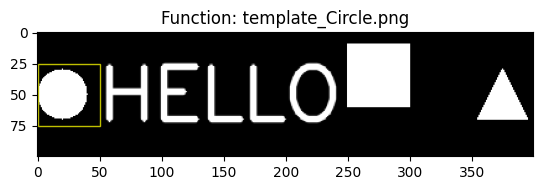

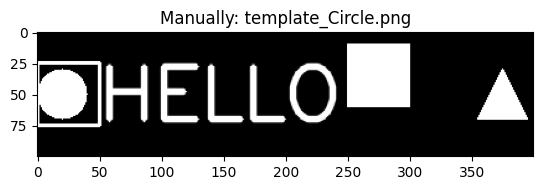

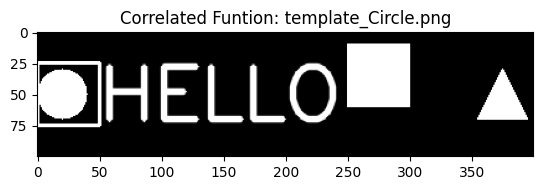

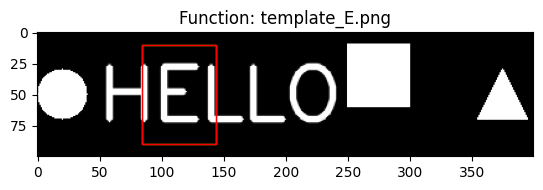

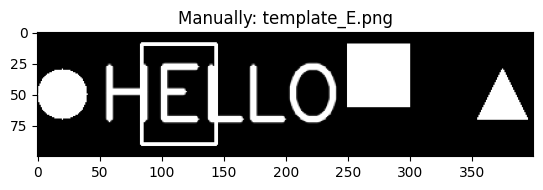

...

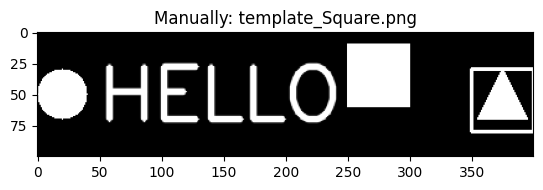

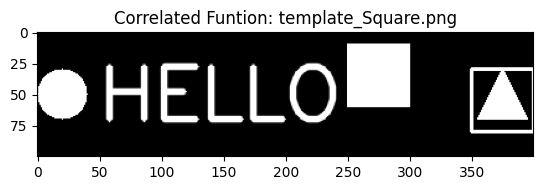

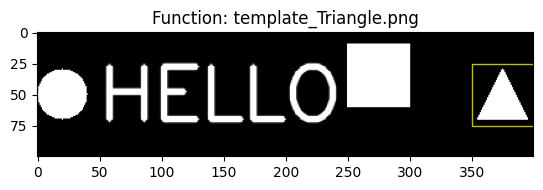

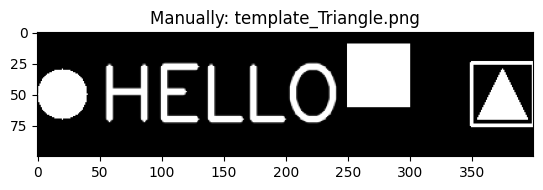

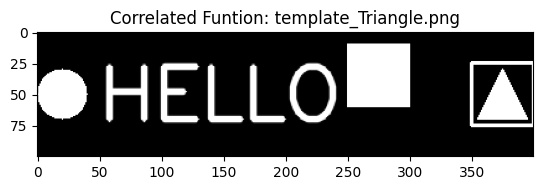

In [ ]:
from skimage.feature import match_template, peak_local_max
from scipy.signal import correlate2d
def resize_image(image, scale_percent):
    # Calculate the new dimensions of the image
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
    # Resize the image
    resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
    return resized

#WITH FUNCTION CORRELATE2D
def normalize(img):
    return (img - np.mean(img)) / np.std(img)

def template_matching_ncc_function(image, template):
    image_norm = normalize(image)
    template_norm = normalize(template)
    #Compute cross-correlation
    ncc = correlate2d(image_norm, template_norm, mode='valid')
    #Find the location of maximum correlation
    ij = np.unravel_index(np.argmax(ncc), ncc.shape)
    x, y = ij[::-1]
    #Draw bounding box around the matched region
    h, w = template.shape[:2]
    cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
    return image

#MANUALLY

def template_matching_ncc_manual(image,template):
    #Normalize the images
    image_norm = normalize(image)
    template_norm = normalize(template)
    #Compute cross-correlation manually
    h, w = template_norm.shape
    ncc = np.empty((image_norm.shape[0] - h + 1, image_norm.shape[1] - w + 1))
    for i in range(ncc.shape[0]):
        for j in range(ncc.shape[1]):
            ncc[i, j] = np.sum(image_norm[i:i+h, j:j+w] * template_norm)
    #Find the location of maximum correlation
    ij = np.unravel_index(np.argmax(ncc), ncc.shape)
    x, y = ij[::-1]
    #Draw bounding box around the matched region
    h, w = template.shape[:2]
    cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
    return image

#FUNCTION
def funct_Square(gray_image, template):
    scale_factor = 2
    template = resize_image(template, scale_percent = 65)
    result = match_template(gray_image, template)
    x, y = np.unravel_index(np.argmax(result), result.shape)
    template_width, template_height = template.shape

    # Increase the size of the boundary box
    template_width *= scale_factor
    template_height *= scale_factor

    # Adjust the centered position to keep the box centered 
    x = (x - (template_width * (scale_factor - 1)) / 2)+30
    y = (y - (template_height * (scale_factor - 1)) / 2)+30

    rect = plt.Rectangle((y, x), template_height, template_width, color='y', fc='none')
    plt.gca().add_patch(rect)
    
    # Create a list to store all the rectangles
    rectangles = []
    
    template_width, template_height = template.shape
    for x, y in peak_local_max(result, threshold_abs=0.9):
        rect = plt.Rectangle((y, x), template_height, template_width, color='red', 
                            fc='none')
        plt.gca().add_patch(rect)
        
        # Add the rectangle to the list
        rectangles.append(rect) 
    # Return the list of rectangles
    return rectangles
def funct(gray_image, template):
    result = match_template(gray_image, template)
    x, y = np.unravel_index(np.argmax(result), result.shape)
    template_width, template_height = template.shape
    rect = plt.Rectangle((y, x), template_height, template_width, color='y', 
                        fc='none')
    plt.gca().add_patch(rect)
    
    # Create a list to store all the rectangles
    rectangles = []
    
    template_width, template_height = template.shape
    for x, y in peak_local_max(result, threshold_abs=0.65):
        rect = plt.Rectangle((y, x), template_height, template_width, color='red', 
                            fc='none')
        plt.gca().add_patch(rect)
        
        # Add the rectangle to the list
        rectangles.append(rect)
    # Return the list of rectangles
    return rectangles

# MAIN
image = cv2.imread("images/template/template_example.png",cv2.IMREAD_GRAYSCALE)
if image is None:
    print("Image not found")
else:
    templates = ["template_Circle.png","template_E.png","template_H.png","template_L.png","template_O.png","template_Square.png","template_Triangle.png"]
    j = 0
    for template in templates:
        template = cv2.imread(f"images/template/{template}",cv2.IMREAD_GRAYSCALE)
        if template is None:
            print("Template not found")
        else:
            copies = []
            for n in range(3):
                image_copy = image.copy() #We copy image to keep original
                copies.append(image_copy)

            if j == 5:
                title = []
                funct_Square(copies[0],template)
                title1 = "Function: "+templates[j]
                title.append(title1)
                template_matching_ncc_manual(copies[1],template)
                title2 = "Manually: "+templates[j]
                title.append(title2)
                template_matching_ncc_function(copies[2], template)
                title3 = "Correlated Funtion: "+templates[j]
                title.append(title3)
                for i in range(3):
                    plt.imshow(copies[i], cmap=plt.cm.gray)
                    plt.title(title[i])
                    plt.show()
            
            else:
                title = []
                funct(copies[0],template)
                title1 = "Function: "+templates[j]
                title.append(title1)
                template_matching_ncc_manual(copies[1],template)
                title2 = "Manually: "+templates[j]
                title.append(title2)
                template_matching_ncc_function(copies[2], template)
                title3 = "Correlated Funtion: "+templates[j]
                title.append(title3)
                for i in range(3):
                    plt.imshow(copies[i], cmap=plt.cm.gray)
                    plt.title(title[i])
                    plt.show()        
        j+=1


## Fourier Transform



#### **Objective**:
You are provided with three images, each corrupted by one or more periodic frequencies. Your task is to process these images using Fourier Transform techniques to identify and remove the corrupting frequencies.

- Image 1 has one specific corrupting frequency.
- Image 2 has another unique corrupting frequency.
- Image 3 has both frequencies from Image 1 and Image 2.

---

#### Guideline:
1. Use Fourier Transform to convert each image to the frequency domain. (you can use libraries for this)
2. Analyze the Fourier spectrum to identify the corrupting frequencies.
3. Remove the identified frequencies and perform an Inverse Fourier Transform to obtain the cleaned image.
4. Compare the cleaned images with the original corrupted ones and quantify the improvements.

---
#### Expected results:
- Cleaned images


In [ ]:
from skimage.io import imread, imshow
from skimage.color import rgb2hsv, rgb2gray, rgb2yuv
from skimage import color, exposure, transform
from skimage.exposure import equalize_hist

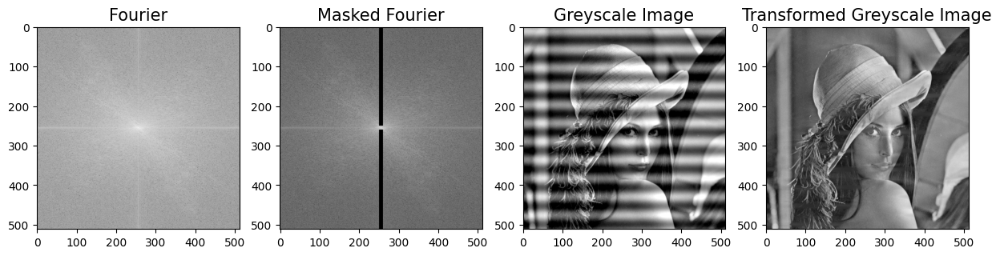

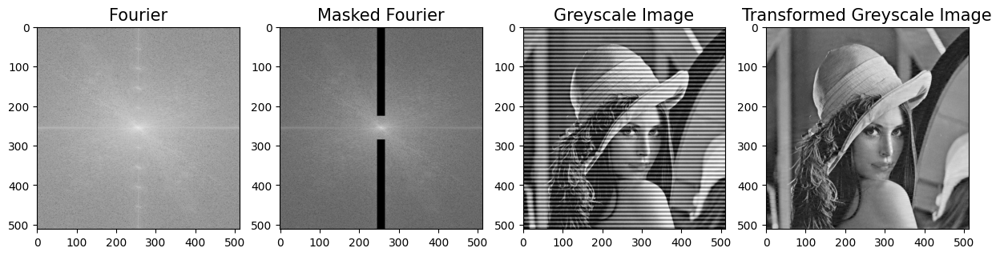

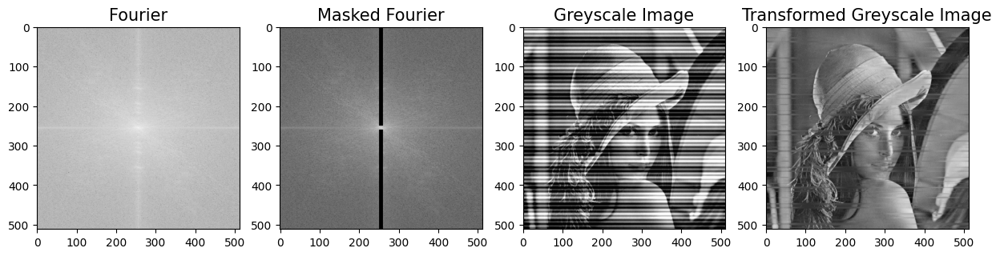

In [ ]:
from scipy.fftpack import fft2, ifft2, fftshift, ifftshift

def Fourier(image,i):
    # Apply Fourier Transform to the image (transform image from spatial to frequency domain)
    fourier = np.fft.fft2(image) # Applies 2D FFT to greyscale image
    fourier = np.fft.fftshift(fourier) # Shifts 0-frequency component to middle (FTT computes it at start) 
                                         # - more convinient for visualization
    #Get magnitude spectrum
    frequency_magnitudes = np.log(abs(fourier))  # Log scaling for visualization
    #Get center x-axis
    rows, cols = frequency_magnitudes.shape
    center_x, center_y = cols // 2, rows // 2  
    #Vertical mask: 
    if i==1: #If it's image 2
        fourier[:center_x-30,center_y-10:center_y+10] = 1 #good for image 2
        fourier[-center_x+30:, center_y-10:center_y+10] = 1
    else:
        fourier[:center_x-5,center_y-5:center_y+5] = 1 #good for image 1 and 3
        fourier[-center_x+5:, center_y-5:center_y+5] = 1

    #Visualization
    fig, ax = plt.subplots(1,4,figsize=(15,15))
    ax[0].imshow(np.log(frequency_magnitudes),cmap="gray")
    ax[0].set_title("Fourier", fontsize = 15)
    ax[1].imshow(np.log(np.abs(fourier)), cmap='gray') #freq magnitudes
    ax[1].set_title('Masked Fourier', fontsize = 15)
    ax[2].imshow(image, cmap = 'gray')
    ax[2].set_title('Greyscale Image', fontsize = 15)
    ax[3].imshow(abs(np.fft.ifft2(fourier)), cmap='gray')
    ax[3].set_title('Transformed Greyscale Image', fontsize = 15)

#MAIN
images=["fourier_1.jpg","fourier_2.jpg","fourier_3.jpg"]
for i in range(len(images)):
    image = cv2.imread(f"images/fourier/{images[i]}",cv2.IMREAD_GRAYSCALE)
    if image is None:
        print("Image not found")
    else:
        Fourier(image,i)



## Extra section

In this section we will include extra work we've done, even though some extra functions and implementations are already added mixed with the obligatory ones.

### **1. Working with color images**

In [ ]:
# LIBRARIES
from skimage import io
from skimage.io import imshow, imread
from skimage.transform import downscale_local_mean
from skimage import img_as_uint
from skimage.color import rgb2gray
from skimage.color import gray2rgb
from skimage.color import rgb2hsv
from skimage.color import hsv2rgb

In [ ]:
#IMAGES

image_1 = cv2.cvtColor(cv2.imread("images/lenna.png",cv2.COLOR_BGR2RGB), cv2.COLOR_BGR2RGB) 
image_2 = cv2.cvtColor(cv2.imread("images/casacampo.jpg",cv2.COLOR_BGR2RGB) , cv2.COLOR_BGR2RGB)
image_3 = cv2.cvtColor(cv2.imread("images/city.jpg",cv2.COLOR_BGR2RGB) , cv2.COLOR_BGR2RGB)
image_4 = cv2.cvtColor(cv2.imread("images/two-tone-ink-cloud.jpg",cv2.COLOR_BGR2RGB) , cv2.COLOR_BGR2RGB)

images = [image_1, image_2, image_3,image_4]


#### 1.1. Applying linear filters to RGB image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


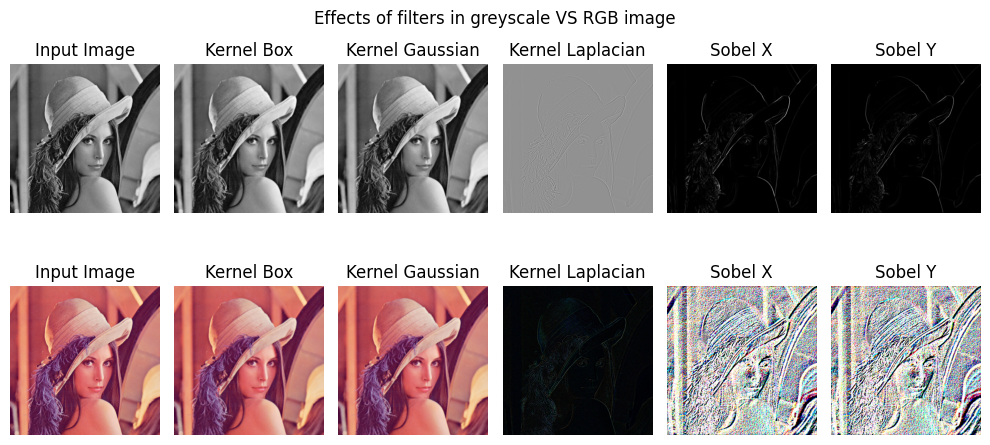

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


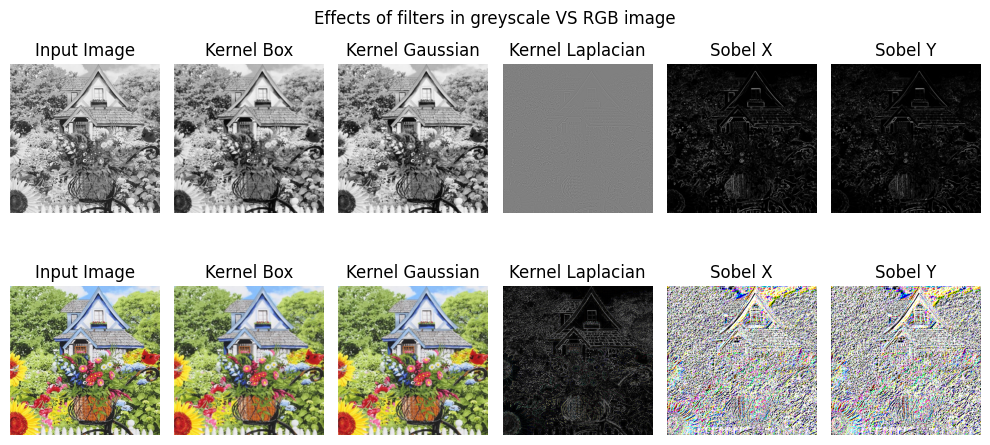

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


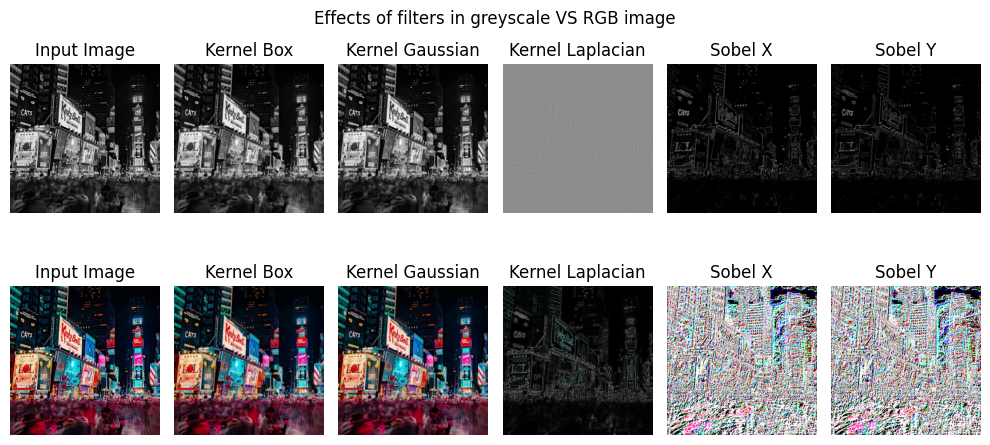

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


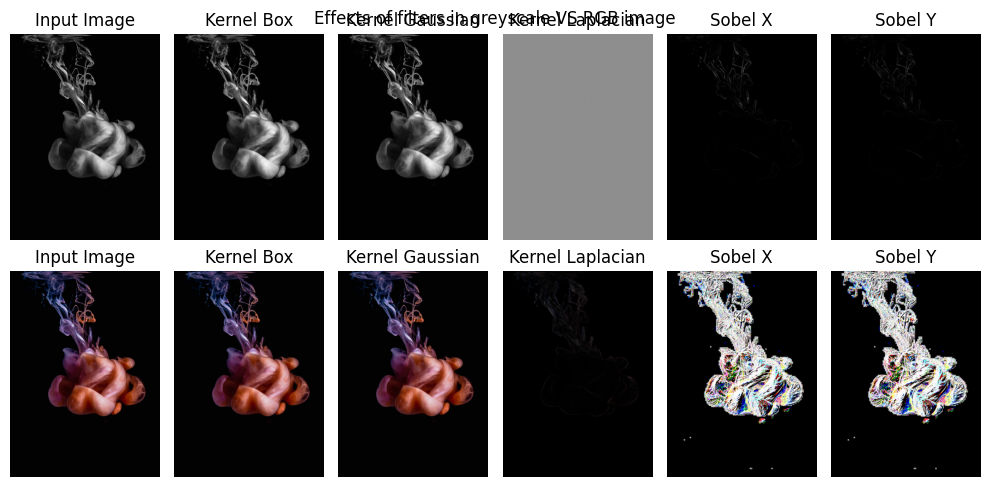

In [ ]:
#Compare filters for greyscale and rgb image
filters_1 = [kernel_box,kernel_gaussian,kernel_Laplacian]
filters_2 = [sobel_x,sobel_y,Prewitt_x,Prewitt_y]

for image in images: 
    image2 = rgb2gray(image)
    outputs_1 = [image2] #Store greyscale image results
    outputs_2 = [image] #Store RGB image results
    #Individual kernels
    for i in range(len(filters_1)):
        #Greyscale
        output1 = cv2.filter2D(image2,-1,filters_1[i])
        outputs_1.append(output1)
        #Color image
        output2 = cv2.filter2D(image,-1,filters_1[i])
        outputs_2.append(output2)
    #Double kernels
    #output_image = cv2.filter2D(image, -1, kernel)
    for k in range(len(filters_2)//2):
        #Greyscale
        out_image_1_1 = cv2.filter2D(image2,-1, filters_2[k])
        out_image_1_2 = cv2.filter2D(image2,-1, filters_2[k+1])
        output_image_1 = (out_image_1_1**2+out_image_1_2**2)**1/2
        outputs_1.append(output_image_1)
        #Colorscale
        out_image_2_1 = cv2.filter2D(image,-1, filters_2[k])
        out_image_2_2 = cv2.filter2D(image,-1, filters_2[k+1])
        output_image_2 = (out_image_2_1**2+out_image_2_2**2)**1/2
        outputs_2.append(output_image_2)
    
    #PRINT IMAGES
    outputs = [outputs_1, outputs_2]
    output_names = ["Input Image","Kernel Box","Kernel Gaussian","Kernel Laplacian","Sobel X","Sobel Y","Prewitt X","Prewitt Y"]
    fig, axes = plt.subplots(len(outputs), len(outputs_1), figsize=(10, 5))
    for x in range(len(outputs)):
        for y in range(len(outputs_1)):
            axes[x,y].imshow(outputs[x][y], cmap='gray')
            axes[x,y].set_title(output_names[y])
            axes[x,y].axis("off")
    plt.tight_layout()
    plt.suptitle("Effects of filters in greyscale VS RGB image")
    plt.show()


#### 1.2. Show different image color types

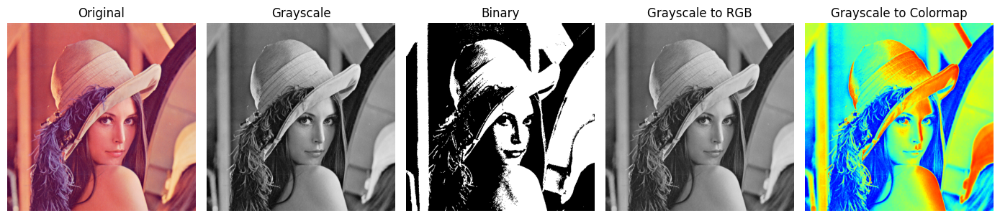

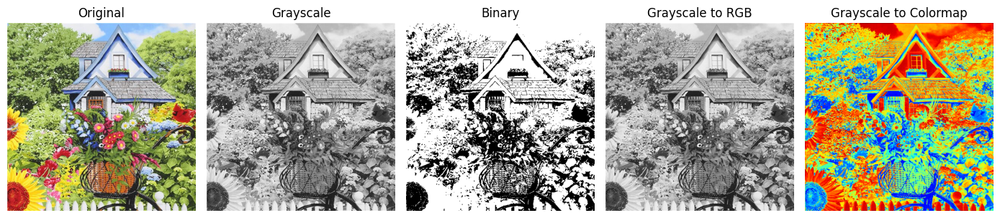

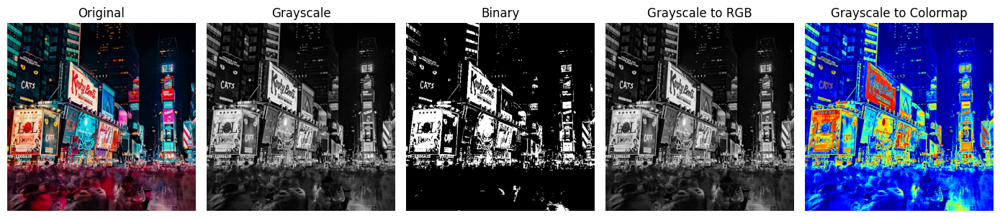

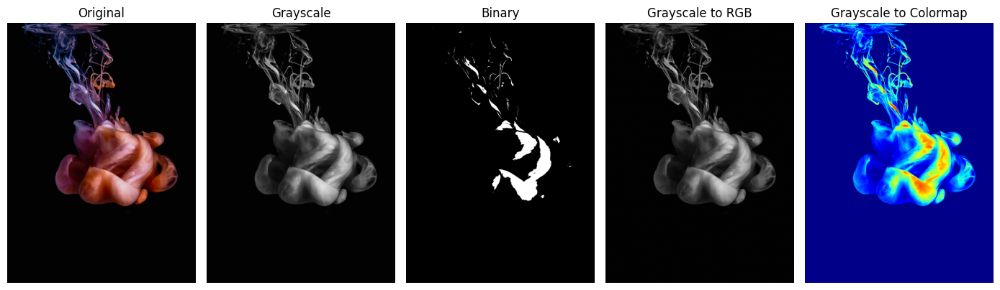

In [ ]:
def color_types(image):
    # Convert the image to grayscale
    grayscale = rgb2gray(image)
    # Convert the grayscale image to binary
    binary = img_as_uint(grayscale > 0.5)
    # Convert the grayscale image to color
    color = gray2rgb(grayscale)
    # Apply the jet colormap
    img_colored = plt.cm.jet(grayscale)
    # Plot the images
    fig, ax = plt.subplots(1, 5, figsize=(14, 4))
    ax[0].imshow(image)
    ax[0].set_title('Original')
    ax[1].imshow(grayscale, cmap='gray')
    ax[1].set_title('Grayscale')
    ax[2].imshow(binary, cmap='gray')
    ax[2].set_title('Binary')
    ax[3].imshow(color)
    ax[3].set_title('Grayscale to RGB')
    ax[4].imshow(img_colored)
    ax[4].set_title('Grayscale to Colormap')

    for ax in fig.axes:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

#Show image color types
for image in images:
    color_types(image)

#### 1.3. Show HSV channels

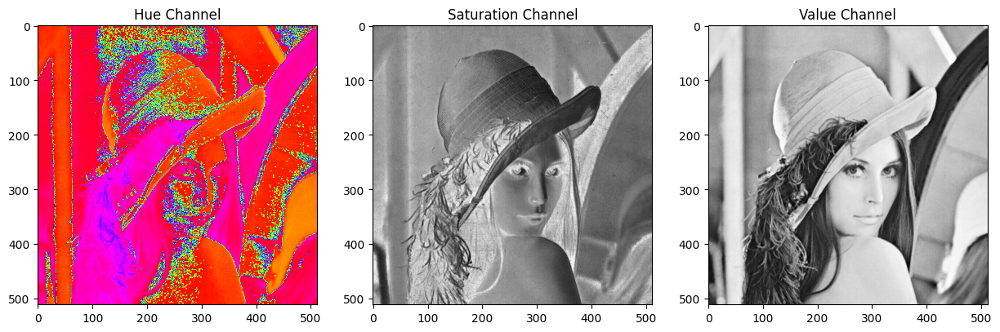

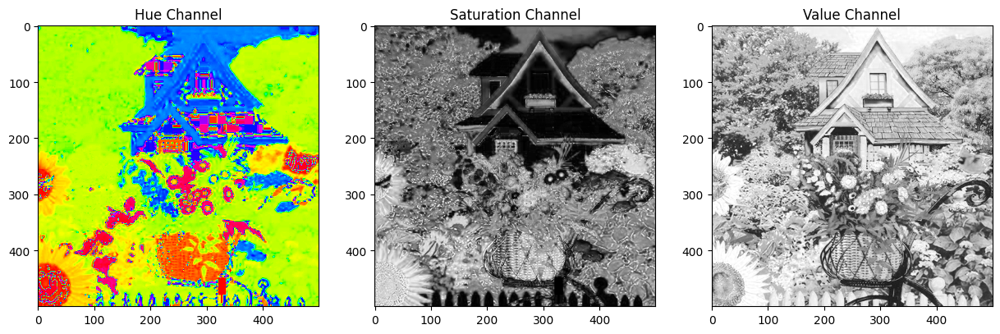

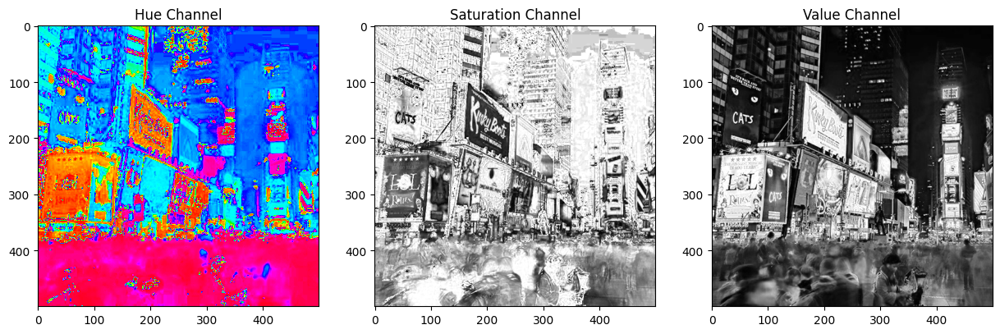

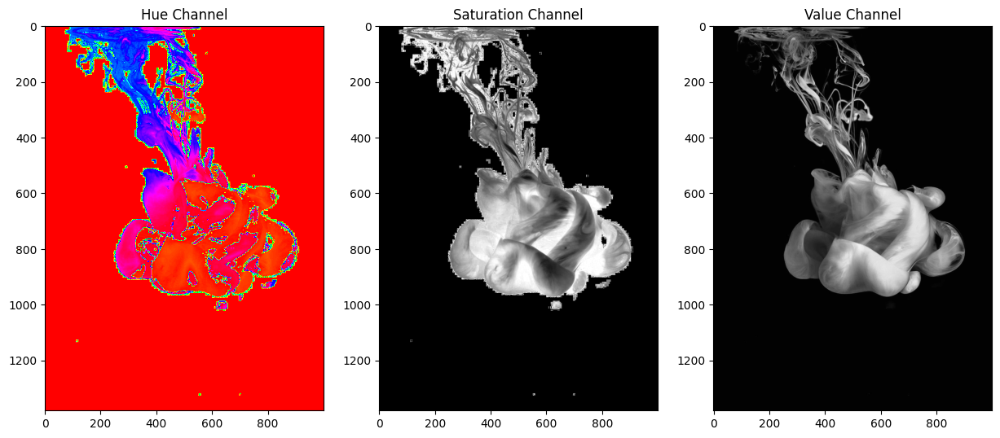

In [ ]:
def hsv_channels(image):
    #Transform image to HSV color space
    hsv_image = rgb2hsv(image)
    # Display the HSV channels
    fig, axs = plt.subplots(1, 3, figsize=(15, 8))
    axs[0].imshow(hsv_image[:, :, 0], cmap='hsv')
    axs[0].set_title('Hue Channel')
    axs[1].imshow(hsv_image[:, :, 1], cmap='gray')
    axs[1].set_title('Saturation Channel')
    axs[2].imshow(hsv_image[:, :, 2], cmap='gray')
    axs[2].set_title('Value Channel')
    plt.show()

for image in images:
    hsv_channels(image)

#### 1.4. Show RGB channels

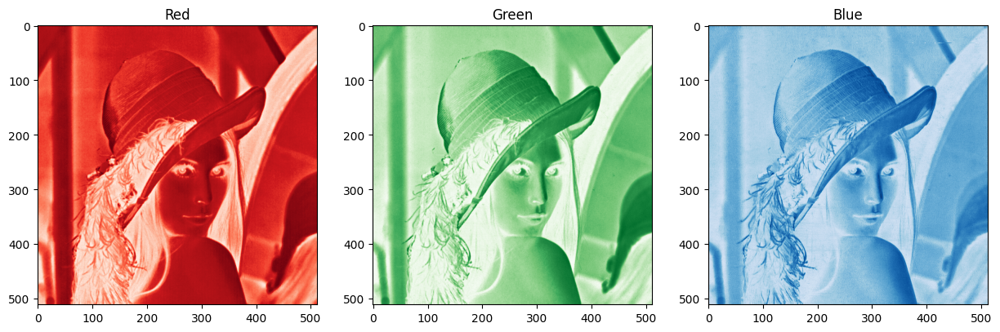

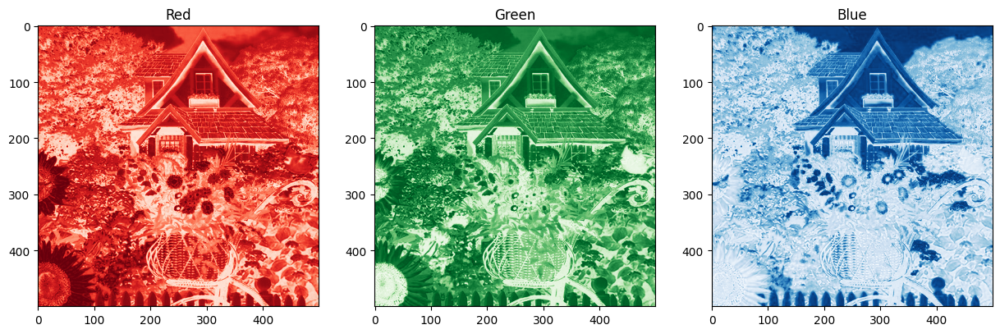

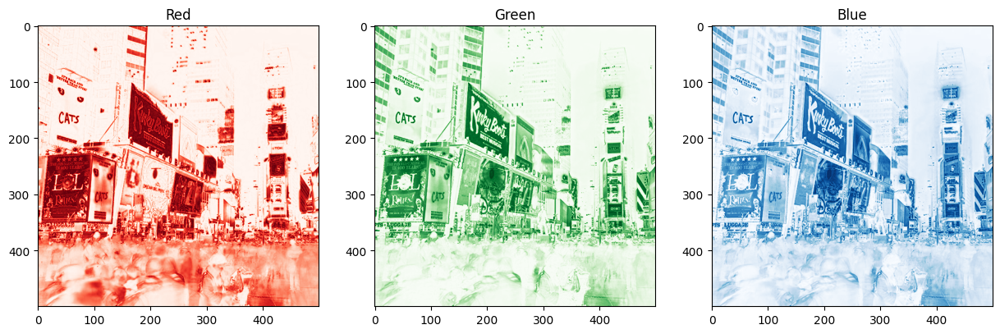

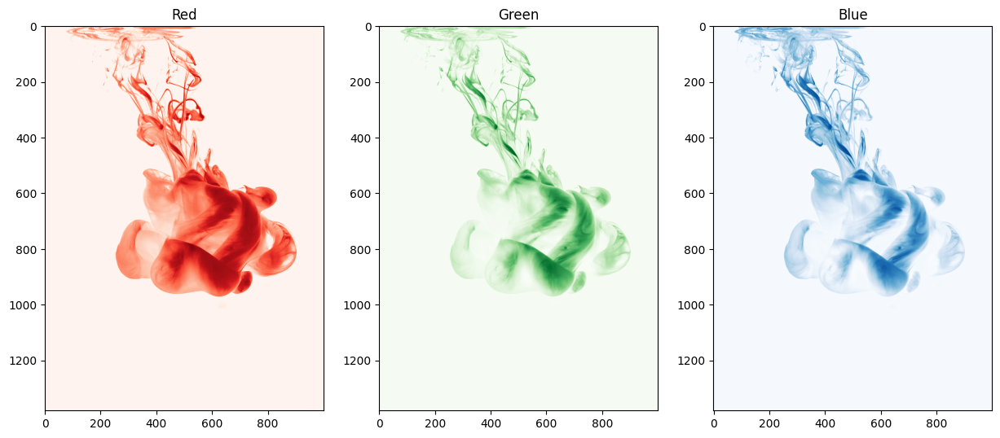

In [ ]:
def rgb_channels(image):
    #Convert the image to HSV color space
    hsv_image = rgb2hsv(image)
    # Convert the HSV image back to RGB
    hsv_to_rgb = hsv2rgb(hsv_image)
    # Display the RGB channels
    fig, ax = plt.subplots(1, 3, figsize=(15, 8))
    ax[0].imshow(hsv_to_rgb[:, :, 0], cmap='Reds')
    ax[0].set_title('Red')
    ax[1].imshow(hsv_to_rgb[:, :, 1], cmap='Greens')
    ax[1].set_title('Green')
    ax[2].imshow(hsv_to_rgb[:, :, 2], cmap='Blues')
    ax[2].set_title('Blue')
    plt.show()

#Show rgb channels
for image in images:
    rgb_channels(image)